# Find the optimum Rotation of CTIO Data in May 2017
==================================================================================================

- author : Sylvie Dagoret-Campagne et Jérémy Neveu
- affiliation : LAL/IN2P3/CNRS, France
- date   : May 29th 2017
- update : May 07st 2017


- The goal is to rotate the image correctly such the dispersive axis must be parallel to X.
Carefull check must be done with eye such the fit of the Y vs X line is correct without bias.
This can be done on every image. Another solution is to force the value of the rotation angle
if one is sure of it.
- So One must decide if he want one average rotation angle or one rotation angle for each image.
Not sure.
- An Hessian method used to detect filaments in maps has been adapted to detect the spectra and 
compute their rotation angles

In [9]:
#%%javascript
#var kernel = IPython.notebook.kernel;
#var thename = window.document.getElementById("notebook_name").innerHTML;
#var command = "theNotebook = " + "'"+thename+"'";
#kernel.execute(command);

In [10]:
#print theNotebook

In [11]:
theNotebook="FindOptRot"

In [12]:
%matplotlib inline
%matplotlib inline
%load_ext autoreload
%autoreload 2
import matplotlib.pyplot as plt
import numpy as np
import math as m

from astropy.modeling import models
from astropy import units as u
from astropy import nddata
from astropy.io import fits
import re
import os, sys
sys.path.append('../../common_tools')
from scan_holo import *

In [13]:
import ccdproc
print 'ccdproc version',ccdproc.__version__

from astropy.modeling import models

ccdproc version 1.0.1


In [14]:
from scipy import stats  
from scipy import ndimage
from datetime import datetime, timedelta
from mpl_toolkits.mplot3d import Axes3D
import scipy.signal
from matplotlib import cm

In [15]:
import bottleneck as bn  # numpy's masked median is slow...really slow (in version 1.8.1 and lower)
print 'bottleneck version',bn.__version__

bottleneck version 1.2.0


In [16]:
import photutils
from astropy.stats import sigma_clipped_stats
from photutils import daofind
from photutils import CircularAperture
from astropy.visualization import SqrtStretch
from astropy.visualization.mpl_normalize import ImageNormalize
#from photutils.background import Background2D
from photutils import Background2D, SigmaClip, MedianBackground

In [17]:
%load_ext Cython

In [18]:
from IPython.display import Image, display

In [19]:
import matplotlib
matplotlib.rc('xtick', labelsize=20) 
matplotlib.rc('ytick', labelsize=20) 

In [20]:
# to enlarge the sizes
params = {'legend.fontsize': 'x-large',
          'figure.figsize': (15, 15),
         'axes.labelsize': 'x-large',
         'axes.titlesize':'x-large',
         'xtick.labelsize':'x-large',
         'ytick.labelsize':'x-large'}
plt.rcParams.update(params)

In [21]:
############################################################################
def ensure_dir(f):
    d = os.path.dirname(f)
    if not os.path.exists(f):
        os.makedirs(f)
#########################################################################

### Output directory for images generated in the notebook view (not true fits images)

In [22]:
dir_top_images="images_notebooks/"+theNotebook ### Top directory to save images

In [23]:
ensure_dir(dir_top_images) # create that directory

### input directory of fits images

In [24]:
inputdir="cut_fitsimages"
MIN_IMGNUMBER=208  # skip the 58 which is not at the right place
MAX_IMGNUMBER=284
object_name='HD205905 May 30th'
SelectTagRe='^cutimg_20170530_([0-9]+).fits$' # regular expression to select the file
SearchTagRe='^cutimg_20170530_[0-9]+.fits$'
NBIMGPERROW=4
BigFigSize=(20,100)

### output directory of fits images

In [25]:
outputdir="./rotated_fitsimages"

In [26]:
ensure_dir(outputdir)

## Location of corrected images
----------------------------------

In [27]:
input_filelist=os.listdir(inputdir) 

In [28]:
if '.DS_Store' in input_filelist:
    input_filelist.remove('.DS_Store')
input_filelist=np.array(input_filelist)

In [29]:
print input_filelist

['cutimg_20170530_210.fits' 'cutimg_20170530_211.fits'
 'cutimg_20170530_212.fits' 'cutimg_20170530_213.fits'
 'cutimg_20170530_214.fits' 'cutimg_20170530_215.fits'
 'cutimg_20170530_216.fits' 'cutimg_20170530_217.fits'
 'cutimg_20170530_218.fits' 'cutimg_20170530_219.fits'
 'cutimg_20170530_220.fits' 'cutimg_20170530_221.fits'
 'cutimg_20170530_222.fits' 'cutimg_20170530_223.fits'
 'cutimg_20170530_224.fits' 'cutimg_20170530_225.fits'
 'cutimg_20170530_226.fits' 'cutimg_20170530_227.fits'
 'cutimg_20170530_228.fits' 'cutimg_20170530_229.fits'
 'cutimg_20170530_230.fits' 'cutimg_20170530_231.fits'
 'cutimg_20170530_232.fits' 'cutimg_20170530_233.fits'
 'cutimg_20170530_234.fits' 'cutimg_20170530_235.fits'
 'cutimg_20170530_236.fits' 'cutimg_20170530_237.fits'
 'cutimg_20170530_238.fits' 'cutimg_20170530_239.fits'
 'cutimg_20170530_240.fits' 'cutimg_20170530_241.fits'
 'cutimg_20170530_242.fits' 'cutimg_20170530_243.fits'
 'cutimg_20170530_244.fits' 'cutimg_20170530_245.fits'
 'cutimg_2

In [30]:
indexes_files= [] # global list
filelist_fitsimages= []  # global list

In [31]:
#%%cython

import numpy as np
import re

def MakeFileList(inputdir,input_filelist):
    """
    MakeFileList : Make The List of files to open
    =============
    """
    
#    import numpy as np
#    import re
    indexes_files= [] # global list
    filelist_fitsimages= []  # global list
    

    
    for file in input_filelist: # loop on directories, one per image       
            filename=inputdir+'/'+file
            if re.search('.*fits$',filename):  #example of filename filter
                num_str=re.findall(SelectTagRe,file)[0]
                index=int(num_str)
                filelist_fitsimages.append(filename)
                indexes_files.append(index)
    return indexes_files, filelist_fitsimages


In [32]:
indexes_files, filelist_fitsimages=MakeFileList(inputdir,input_filelist)   # Make the list

In [33]:
indexes_files=np.array(indexes_files)
filelist_fitsimages=np.array(filelist_fitsimages)

In [34]:
print indexes_files

[210 211 212 213 214 215 216 217 218 219 220 221 222 223 224 225 226 227
 228 229 230 231 232 233 234 235 236 237 238 239 240 241 242 243 244 245
 246 247 248 249 250 251 252 253 254 255 256 257 258 259 260 261 262 263
 264 265 266 267 268 269 270 271 272 273 274 275 276 277 278 279 280 281
 282 283 284]


In [35]:
sorted_indexes=np.argsort(indexes_files) # sort the file indexes

In [36]:
sorted_numbers=indexes_files[sorted_indexes]

In [37]:
print sorted_indexes

[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24
 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49
 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74]


In [38]:
#sorted_files= [filelist_fitsimages[index] for index in sorted_indexes] # sort files
sorted_files=filelist_fitsimages[sorted_indexes]

In [39]:
#sorted_files

## Build full filename
----------------------------

In [40]:
sorted_filenames=[]
for file in sorted_files:
    #fullfilename=os.path.join(inputdir,file)
    fullfilename=file
    sorted_filenames.append(fullfilename)

In [41]:
#sorted_filenames=np.array(sorted_filenames)
sorted_filenames=np.copy(sorted_files)

In [42]:
print sorted_filenames.shape

(75,)


## Acces to data of  images
----------------------------------

In [43]:
all_dates = []
all_airmass = []
all_images = []
all_titles = []
all_header = []
all_img = []
all_filt = []

In [44]:
%%cython

import numpy as np
from astropy.io import fits

def BuildImages(sorted_filenames,sorted_numbers,object_name):
    """
    BuildRawImages
    ===============
    """

    
    all_dates = []
    all_airmass = []
    all_images = []
    all_titles = []
    all_header = []
    all_expo = []
    all_filt = []
   
    NBFILES=sorted_filenames.shape[0]

    for idx in range(NBFILES):  
        
        file=sorted_filenames[idx]    
        
        hdu_list=fits.open(file)
        header=hdu_list[0].header
        #print header
        date_obs = header['DATE-OBS']
        airmass = header['AIRMASS']
        expo = header['EXPTIME']
        filters = header['FILTERS']
        num=sorted_numbers[idx]
        title=object_name+" z= {:3.2f} Nb={}".format(float(airmass),num)
        image_corr=hdu_list[0].data
        image=image_corr
        
        all_dates.append(date_obs)
        all_airmass.append(float(airmass))
        all_images.append(image)
        all_titles.append(title)
        all_header.append(header)
        all_expo.append(expo)
        all_filt.append(filters)
        hdu_list.close()
        
    return all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt

In [45]:
all_dates,all_airmass,all_images,all_titles,all_header,all_expo,all_filt=BuildImages(sorted_files,sorted_numbers,object_name)

## Show images
-----------------------

In [46]:
len(all_images)

75

In [47]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m
global NBIMGPERROW
    
def ShowImages(all_images,all_titles,object_name,dir_top_images):
    """
    ShowRawImages: Show the raw images without background subtraction
    ==============
    """
    NBIMGPERROW=4
    NBIMAGES=len(all_images)
    #MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERROW))))

    thex0 = []
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,3*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        xprofile=np.sum(all_images[index],axis=0)
        x0=np.where(xprofile==xprofile.max())[0][0]
        thex0.append(x0)
        im=axarr[iy,ix].imshow(all_images[index],origin='lower',cmap='rainbow',vmin=-10,vmax=800)
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(color='white', ls='solid')
    title='Images of {}'.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'input_images.pdf')
    plt.savefig(figfilename)  
    return thex0

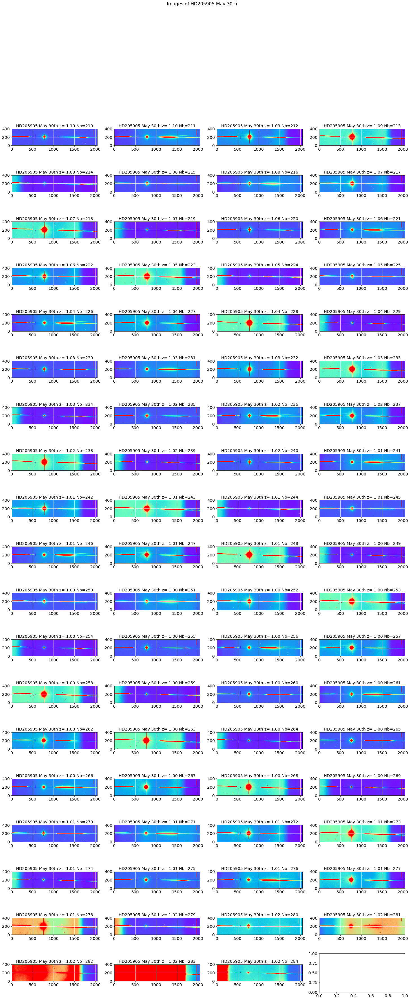

In [48]:
thex0=ShowImages(all_images,all_titles,object_name,dir_top_images)

## Duplicate the images

In [49]:
all_images2=[]
for image in all_images:
    image_copy=np.copy(image)
    all_images2.append(image_copy)

## Subtract Background

In [50]:
for theimage in all_images2:
    NR,NC=theimage.shape
    EmptySkyBackground=np.zeros([NR,NC])
    SkyBackground=EmptySkyBackground+np.median(theimage,axis=0)
    theimage-=SkyBackground

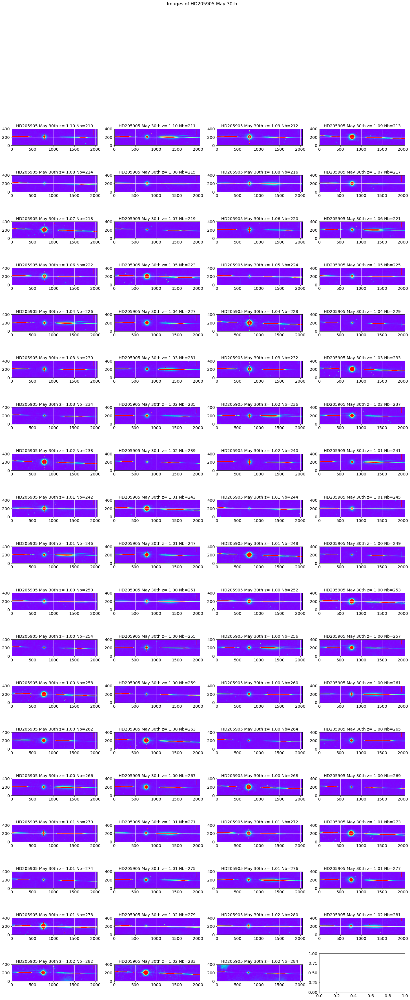

In [51]:
thex02=ShowImages(all_images2,all_titles,object_name,dir_top_images)

### Shows the transverse profile

In [52]:
DeltaX=600
w=20
ws=80

In [53]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import math as m    
import os


def ShowTransverseProfile(all_images,all_titles,object_name,all_expo,dir_top_images):
    """
    ShowTransverseProfile: Show the raw images without background subtraction
    =====================
    """
    NBIMGPERROW=4
    NBIMAGES=len(all_images)
    #MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBIMAGES)/float(NBIMGPERROW))))
    DeltaX=600
    w=20
    ws=80
    thespectra= []
    they0= []
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        data=np.copy(all_images[index])
        data[:,DeltaX-ws:DeltaX+ws]=0
        if(all_expo[index]<=0):
            yprofile=np.sum(data,axis=1)  #very special case
        else:
            yprofile=np.sum(data,axis=1)/all_expo[index]
        ymin=1
        ymax=yprofile.max()
        y0=np.where(yprofile==ymax)[0][0]
        they0.append(y0)
        #im=axarr[iy,ix].imshow(data,vmin=-10,vmax=50)
        axarr[iy,ix].semilogy(yprofile)
        axarr[iy,ix].semilogy([y0,y0],[ymin,ymax],'r-')
        axarr[iy,ix].semilogy([y0-w,y0-w],[ymin,ymax],'k-')
        axarr[iy,ix].semilogy([y0+w,y0+w],[ymin,ymax],'k-')
        axarr[iy,ix].set_ylim(1000.,2e5)
        spectrum2D=np.copy(data[y0-w:y0+w,:])
        xprofile=np.sum(spectrum2D,axis=0)
        thespectra.append(xprofile/(2.*float(w))/all_expo[index])
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
    title='Spectrum tranverse profile '.format(object_name)
    plt.suptitle(title,size=16)
    figfilename=os.path.join(dir_top_images,'transverse_profile.pdf')
    plt.savefig(figfilename)  
    return thespectra,they0

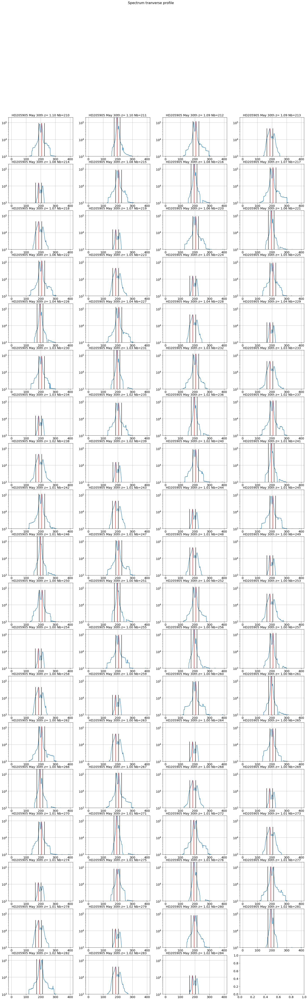

In [54]:
thespectra,they0=ShowTransverseProfile(all_images2,all_titles,object_name,all_expo,dir_top_images)

In [58]:
%%cython
import numpy as np
import matplotlib.pyplot as plt
import os
import math as m

def ShowSpectrumProfile(spectra,all_titles,object_name,dir_top_images):
    """
    ShowSpectrumProfile: Show the raw images without background subtraction
    =====================
    """
    NBIMGPERROW=4
    NBSPEC=len(spectra)
    #MAXIMGROW=int(NBSPEC/NBIMGPERROW)+1
    MAXIMGROW=max(2,int(m.ceil(float(NBSPEC)/float(NBIMGPERROW))))
    
    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBSPEC):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        axarr[iy,ix].plot(spectra[index])
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(True)
        axarr[iy,ix].set_ylim(0.,200.)
    title='Spectrum 1D profile '.format(object_name)
    figfilename=os.path.join(dir_top_images,'longitudinal_profile.pdf')
    plt.savefig(figfilename)  
    plt.suptitle(title,size=16)

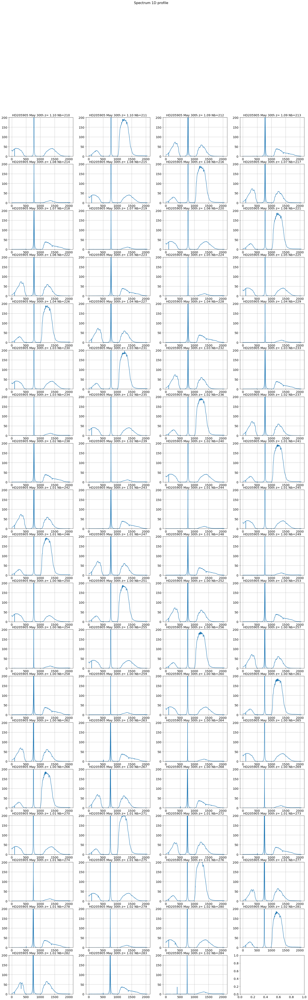

In [59]:
ShowSpectrumProfile(thespectra,all_titles,object_name,dir_top_images)

In [60]:
print they0

[206, 195, 207, 185, 185, 205, 194, 207, 186, 185, 205, 195, 207, 185, 185, 206, 195, 207, 185, 185, 206, 194, 206, 185, 185, 205, 195, 207, 186, 186, 205, 195, 207, 184, 184, 205, 196, 207, 185, 185, 209, 196, 207, 185, 184, 205, 194, 207, 185, 184, 205, 196, 207, 185, 184, 205, 194, 206, 185, 184, 205, 193, 192, 185, 183, 194, 193, 191, 185, 184, 194, 193, 192, 185, 184]


In [61]:
print thex0

[1958, 1958, 778, 1958, 1958, 1958, 1958, 779, 1958, 1958, 1958, 1958, 779, 1958, 1958, 1958, 1958, 778, 1958, 1958, 1958, 1958, 778, 1958, 1958, 1958, 1958, 777, 1958, 1958, 1958, 1958, 776, 1958, 1958, 1958, 1958, 773, 1958, 1958, 772, 1958, 1958, 1958, 1958, 770, 1958, 769, 1958, 1958, 765, 1958, 763, 1958, 1958, 1958, 1958, 758, 1958, 1958, 1958, 1958, 757, 1958, 1958, 1958, 1958, 755, 1958, 1958, 1958, 1958, 751, 1958, 1958]


### Test rotation optimum
----------------------------

In [62]:
from scipy import stats 
from scipy import ndimage
from scipy.optimize import curve_fit

In [63]:
sel=0

In [64]:
image_sel=np.copy(all_images2[sel])
y0=they0[sel]
x0=thex0[sel]

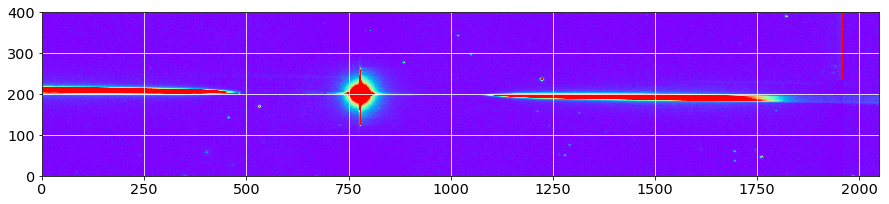

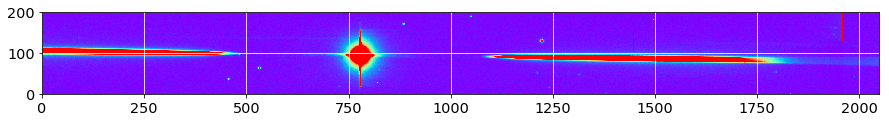

In [65]:
width_cut = 100

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

### find the orientation by the average

In [66]:
def ComputeMedY(data):
    """
    Compute the median of Y vs X to find later the angle of rotation
    """
    NBINSY=data.shape[0]
    NBINSX=data.shape[1]
    the_medianY=np.zeros(NBINSX)
    the_y=np.zeros(NBINSY)
    for ix in np.arange(NBINSX):
        the_ysum=np.sum(data[:,ix])
        for iy in np.arange(NBINSY):
            the_y[iy]=iy*data[iy,ix]
        if(the_ysum>0):
            med=np.sum(the_y)/the_ysum
            the_medianY[ix]=med
    return the_medianY

In [67]:
def ComputeAveY(data):
    """
    Compute the average of Y vs X to find later the angle of rotation
    """
    NBINSY=data.shape[0]
    NBINSX=data.shape[1]
    the_averY=np.zeros(NBINSX)
    the_y=np.zeros(NBINSY)
    for ix in np.arange(NBINSX):
        the_ysum=np.sum(data[:,ix])
        for iy in np.arange(NBINSY):
            the_y[iy]=iy*data[iy,ix]
        if(the_ysum>0):
            med=np.sum(the_y)/the_ysum
            the_averY[ix]=med
    return the_averY

In [68]:

xindex=np.arange(data.shape[1])

In [69]:
#selected_indexes=np.where(np.logical_or(xindex<480,xindex>1100))

In [70]:
#selected_indexes=np.where(np.logical_or(np.logical_and(xindex>100,xindex<200) ,np.logical_and(xindex>1410,xindex<1600)))

In [71]:
selected_indexes=np.where(np.logical_or(np.logical_and(xindex>0,xindex<200) ,np.logical_and(xindex>750,xindex<1600)))

In [72]:
yaver=ComputeAveY(data)

In [73]:
XtoFit=np.array(xindex[selected_indexes])
YtoFit=np.array(yaver[selected_indexes])

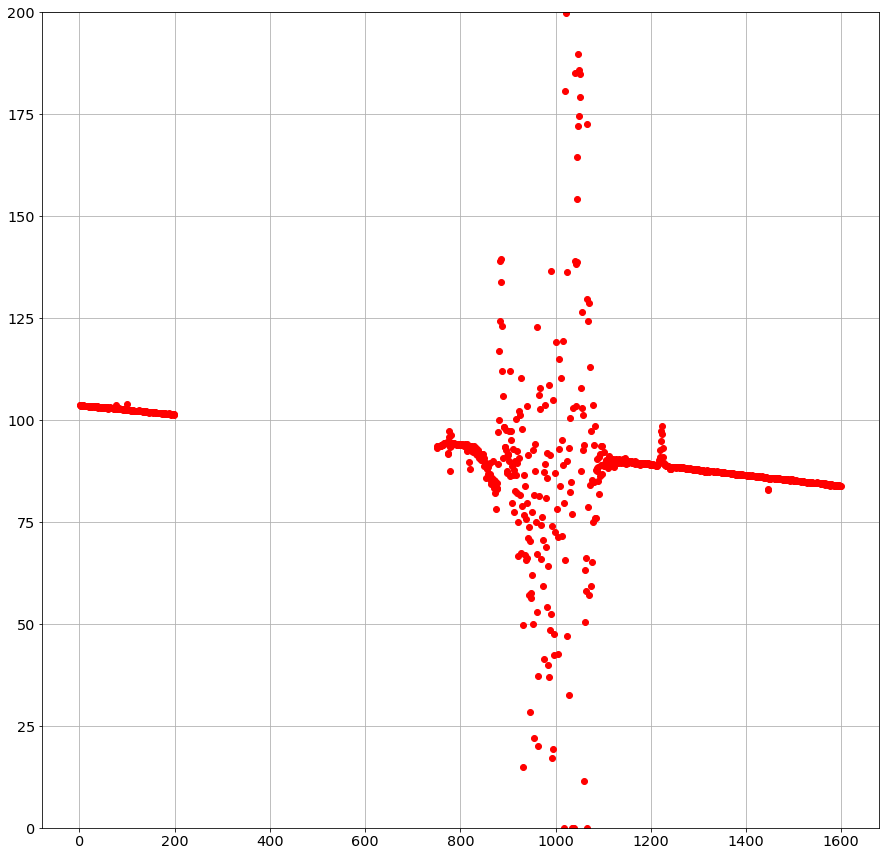

In [74]:
plt.plot(XtoFit,YtoFit,'ro')
plt.ylim(0,200)
plt.grid(True)

In [75]:
selected_indexes2=np.where(np.logical_and(YtoFit<200,YtoFit>0))

In [76]:
XtoFit2=XtoFit[selected_indexes2]
YtoFit2=YtoFit[selected_indexes2]

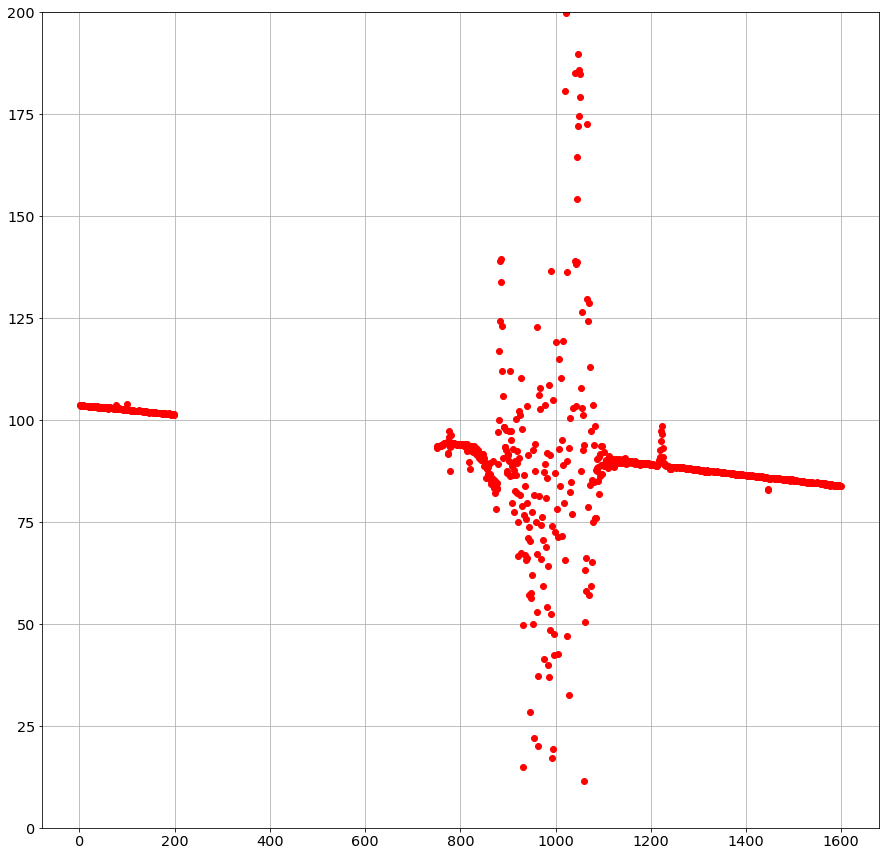

In [77]:
plt.plot(XtoFit2,YtoFit2,'ro')
plt.ylim(0,200)
plt.grid(True)

In [78]:
def fit_func(x, a, b):
    return a*x + b

In [79]:
from scipy.optimize import curve_fit
   

In [80]:
params = curve_fit(fit_func, XtoFit2, YtoFit2)
[a, b] = params[0]

In [81]:
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = fit_func(x_new,a,b)

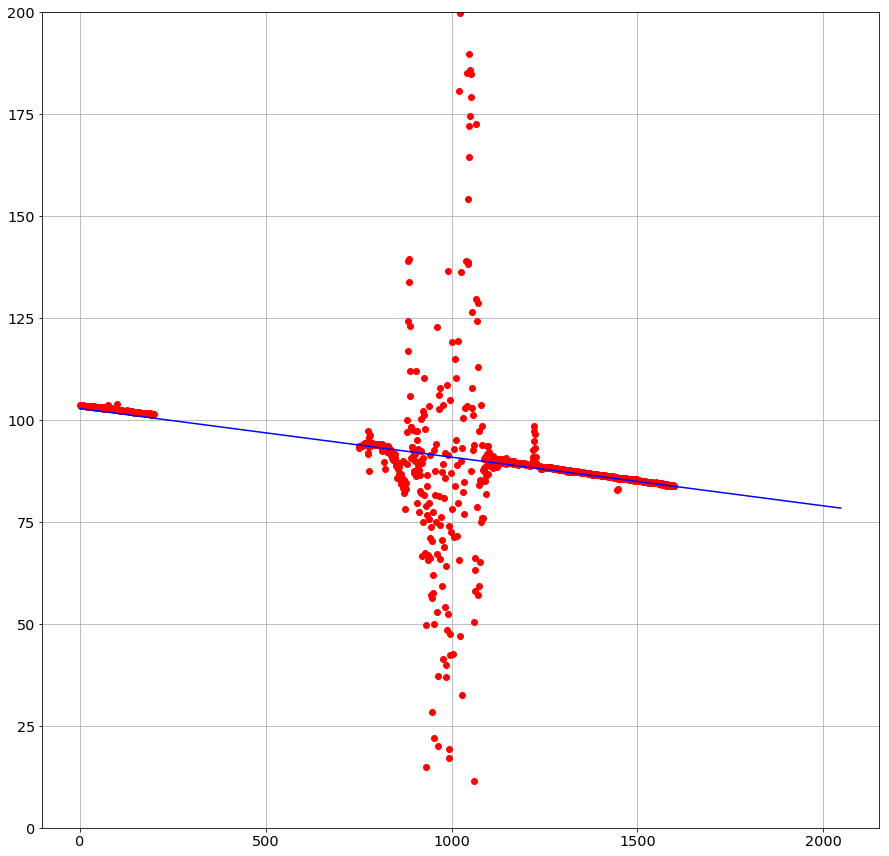

In [82]:
plt.plot(XtoFit2,YtoFit2,'ro')
plt.plot(x_new,y_new,'b-')
plt.ylim(0,200)
plt.grid(True)

In [83]:
print a,b

-0.0119378448544 102.847711465


In [84]:
print np.arctan(a)*180/np.pi

-0.683955637213


### Find rotation by Hessian analysis

La méthode s'inspire des techniques de détection de filmanents dans le milieu interstellaire.
Elle est décrite dans https://arxiv.org/pdf/1409.6728.pdf section 4.1.
Documentation sur le calcul du Hessien : http://scikit-image.org/docs/dev/api/skimage.feature.html#skimage.feature.hessian_matrix

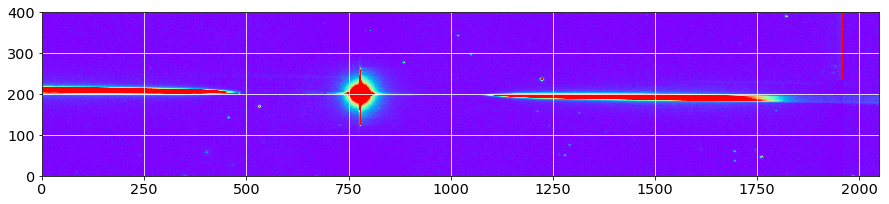

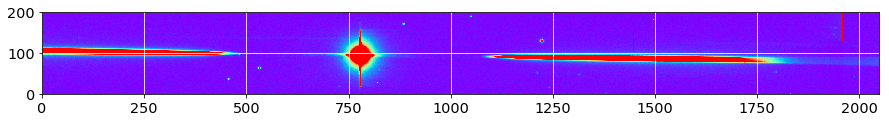

In [85]:
width_cut = 100

plt.imshow(image_sel,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()

In [86]:
from skimage.feature import hessian_matrix
# le paramètre sigma permet de lisser le hessien
Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi

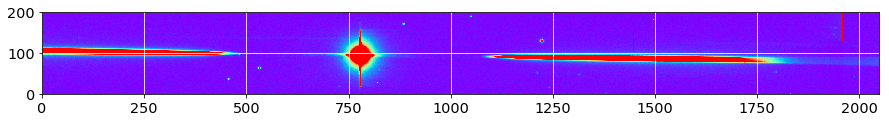

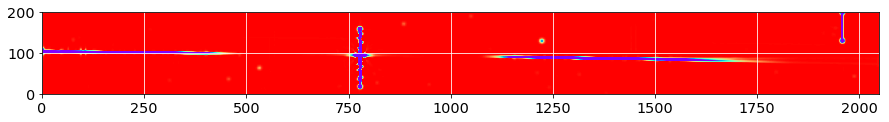

In [87]:
plt.imshow(data,origin='lower',cmap='rainbow',vmin=-10,vmax=800)
plt.grid(color='white', ls='solid')
plt.show()
plt.imshow(lambda_minus,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='white', ls='solid')
plt.show()

Maintenant on va sélectionner le spectre à l'aide d'un seuil pour éliminer le fond.

Number of remaining pixels : 11582


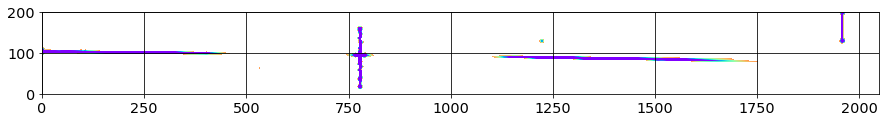

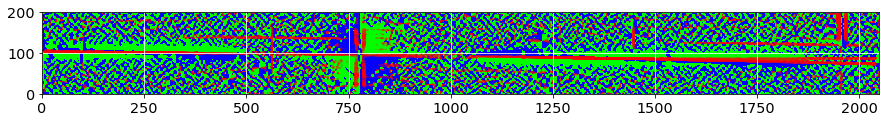

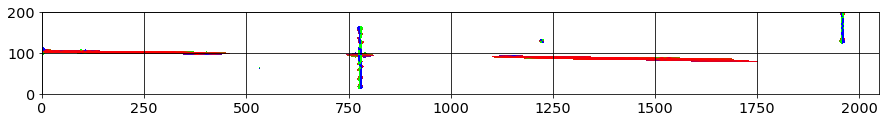

In [88]:
lambda_threshold = -20  

mask = np.where(lambda_minus>lambda_threshold)
lambda_mask = np.copy(lambda_minus)
lambda_mask[mask]=np.nan

theta_mask = np.copy(theta)
theta_mask[mask]=np.nan

print 'Number of remaining pixels :',len(lambda_mask[~np.isnan(lambda_mask)])

plt.imshow(lambda_mask,origin='lower',cmap='rainbow',vmin=-100,vmax=0)
plt.grid(color='black', ls='solid')
plt.show()

plt.imshow(theta,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='white', ls='solid')
plt.show()

plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.grid(color='black', ls='solid')
plt.show()

On sait que l'angle que l'on recherche est petit car l'axe de dispersion du réseau est bien aligné selon x, donc on peut sélectionner.

Number of remaining pixels : 8551


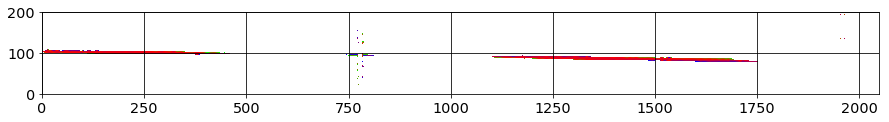

In [89]:
deg_threshold = 8

mask2 = np.where(np.abs(theta)>deg_threshold)
theta_mask[mask2] = np.nan
print 'Number of remaining pixels :',len(theta_mask[~np.isnan(theta_mask)])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
plt.grid(color='black', ls='solid')
plt.show()

Angle median : -0.740945585634


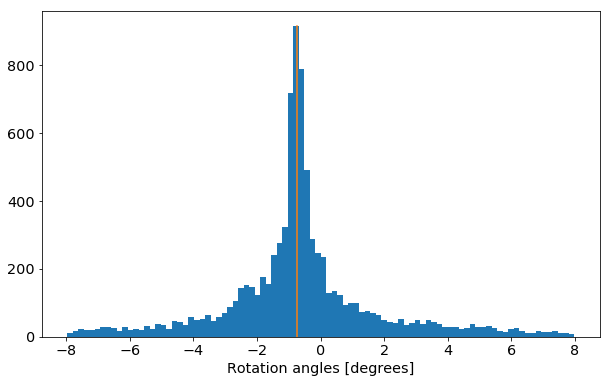

In [90]:
theta_hist = []
theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
theta_median = np.median(theta_hist)
print 'Angle median :',theta_median
fig = plt.figure(figsize=(10,6))
n,bins, patches = plt.hist(theta_hist,bins=int(np.sqrt(len(theta_hist))))
plt.plot([theta_median,theta_median],[0,np.max(n)])
plt.xlabel("Rotation angles [degrees]")
plt.show()

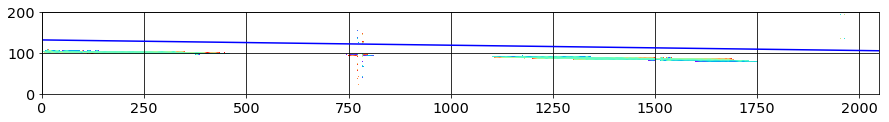

In [91]:
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
plt.imshow(theta_mask,origin='lower',cmap='rainbow',vmin=-deg_threshold,vmax=deg_threshold)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()

On peut aussi essayer de fitter le spectre qui a été détecté par la méthode ci-dessus.

Rotation angle from fit : -0.676780327756


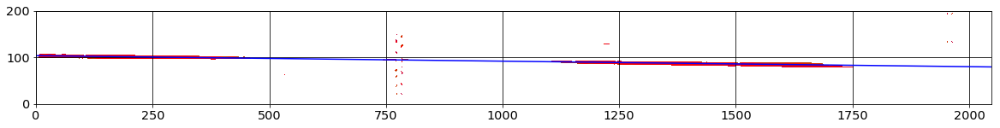

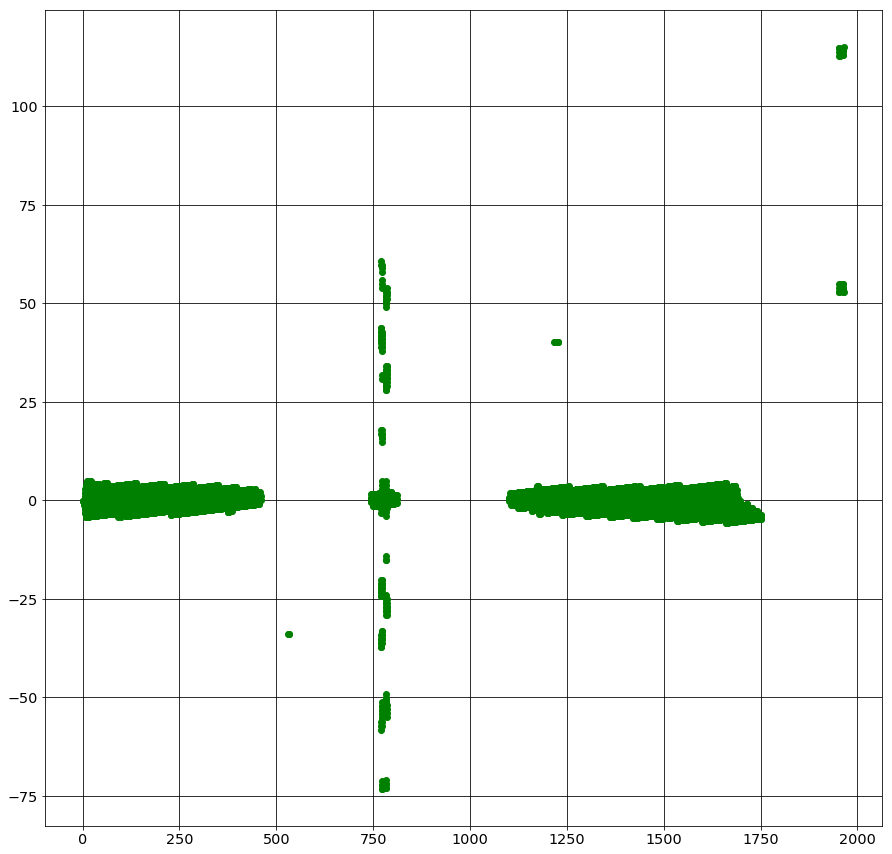

In [92]:
xtofit=[]
ytofit=[]
for iy,y in enumerate(theta_mask):
    for ix,x in enumerate(y):
        if not np.isnan(theta_mask[iy][ix]) :
            if np.abs(theta_mask[iy][ix])>12 : continue
            xtofit.append(ix)
            ytofit.append(iy)
params = curve_fit(fit_func, xtofit, ytofit)
[a, b] = params[0]
x_new = np.linspace(xindex.min(),xindex.max(), 50)
y_new = fit_func(x_new,a,b)
print 'Rotation angle from fit :',np.arctan(a)*180/np.pi
fig = plt.figure(figsize=[20,30])
plt.imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-30,vmax=30)
plt.plot(x_new,y_new,'b-')
plt.grid(color='black', ls='solid')
plt.show()
diff = []
for ix,x in enumerate(xtofit):
    diff.append(ytofit[ix]-fit_func(x,a,b))
plt.plot(xtofit,diff,'go')
plt.grid(color='black', ls='solid')
plt.show()

Je pense que la méthode de fit est plus compliquée dans un champ encombré.

## Find Rotation angle for each image
----------------------------------------------

In [93]:
def ComputeRotationAngle(all_images,thex0,they0,all_titles,object_name):
    """
    ComputeRotationAngle
    ====================
    
    input:
    ------
    all_images
    thex0
    they0
    
    
    output:
    ------
    param_a
    param_b
    
    """
    NBIMAGES=len(all_images)
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    param_a=np.zeros(NBIMAGES)
    param_b=np.zeros(NBIMAGES)

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,4*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        
        image_sel=np.copy(image)
        y0=they0[index]
        x0=thex0[index]
        
        # extract a region of 200 x 1000 centered at y=100,x=500
        
        region=np.copy(image_sel[y0-100:y0+100,:])
        data=np.copy(region)
        
        xindex=np.arange(data.shape[1])
        
        #selected_indexes=np.where(np.logical_or(np.logical_and(xindex>100,xindex<200) ,np.logical_and(xindex>1410,xindex<1600))) 
        selected_indexes=np.where(np.logical_or(np.logical_and(xindex>0,xindex<150) ,np.logical_and(xindex>1500,xindex<1600)))
        # compute Y vs X
        yaver=ComputeAveY(data)
        
        XtoFit=xindex[selected_indexes]
        YtoFit=yaver[selected_indexes]
        # does the fit
        params = curve_fit(fit_func, XtoFit, YtoFit)
        [a, b] = params[0]
        
        param_a[index]=a
        param_b[index]=b
        
        print index,' y = ',a,' * x + ',b
        x_new = np.linspace(xindex.min(),xindex.max(), 50)
        y_new = fit_func(x_new,a,b)
    
        im=axarr[iy,ix].plot(XtoFit,YtoFit,'ro')
        im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        
        axarr[iy,ix].set_ylim(0,200)
        axarr[iy,ix].grid(True)
        
    title='Fit rotation angle of '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
    plt.savefig(figfilename)  
    
    
    return param_a,param_b
    
    

0  y =  -0.01241318417  * x +  103.75932739
1  y =  -0.0111896033261  * x +  114.704674939
2  y =  -0.0165413715374  * x +  105.532178347
3  y =  -0.0345538812723  * x +  143.393483741
4  y =  -0.0277597467316  * x +  137.251641009
5  y =  -0.0111366965643  * x +  104.059080044
6  y =  -0.0106440952061  * x +  114.583523754
7  y =  -0.0165130198672  * x +  105.597863235
8  y =  -0.0340451208647  * x +  141.493779981
9  y =  -0.028079743974  * x +  137.443084045
10  y =  -0.0116583340439  * x +  104.06706497
11  y =  -0.0113604153226  * x +  114.71765061
12  y =  -0.0164466211969  * x +  105.925394003
13  y =  -0.0348404034659  * x +  143.67389162
14  y =  -0.0281789493978  * x +  137.084336535
15  y =  -0.0114127037418  * x +  103.335682301
16  y =  -0.0110939040205  * x +  114.449101656
17  y =  -0.016075781371  * x +  105.351841787
18  y =  -0.0346350494532  * x +  142.921948837
19  y =  -0.02649490246  * x +  134.075988255
20  y =  -0.01169613187  * x +  103.295227085
21  y =  -0.01

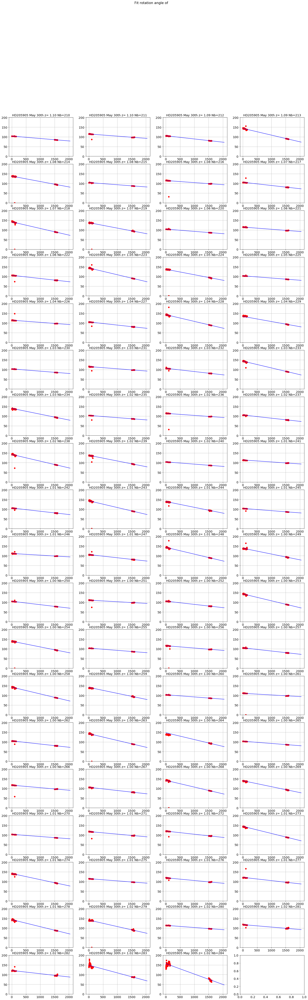

In [94]:
all_a,all_b=ComputeRotationAngle(all_images2,thex0,they0,all_titles,object_name)

In [95]:
all_angles=np.arctan(all_a)*180./np.pi

In [96]:
def ComputeRotationAngleHessian(all_images,thex0,they0,all_titles,object_name):
    """
    ComputeRotationAngle
    ====================
    
    input:
    ------
    all_images
    thex0
    they0
    all_titles
    object_name
    
    output:
    ------
    rotation angles
    
    """
    NBIMAGES=len(all_images)
    NBIMGPERROW=2
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    
    param_theta=np.zeros(NBIMAGES)
    
    ####### PARAMETERS TO BE TUNED #########
    lambda_threshold = -20
    deg_threshold = 8
    width_cut = 100
    ########################################

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,2*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        
        image_sel=np.copy(image)
        y0=they0[index]
        x0=thex0[index]
        
        # extract a region of 200 x 1000 centered at y=100,x=500
        
        region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
        data=np.copy(region)
        
        # compute hessian matrices on the image
        
        Hxx, Hxy, Hyy = hessian_matrix(data, sigma=3, order = 'xy')
        lambda_plus = 0.5*( (Hxx+Hyy) + np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
        lambda_minus = 0.5*( (Hxx+Hyy) - np.sqrt( (Hxx-Hyy)**2 +4*Hxy*Hxy) )
                

        mask = np.where(lambda_minus>lambda_threshold)
        #lambda_mask = np.copy(lambda_minus)
        #lambda_mask[mask]=np.nan

        theta = 0.5*np.arctan2(2*Hxy,Hyy-Hxx)*180/np.pi
        theta_mask = np.copy(theta)
        theta_mask[mask]=np.nan

        mask2 = np.where(np.abs(theta)>deg_threshold)
        theta_mask[mask2] = np.nan
        
        theta_hist = []
        theta_hist = theta_mask[~np.isnan(theta_mask)].flatten()
        theta_median = np.median(theta_hist)
        
        param_theta[index] = theta_median
        
        x_new = np.linspace(xindex.min(),xindex.max(), 50)
        y_new = y0 - width_cut + (x_new-x0)*np.tan(theta_median*np.pi/180.)
    
        im=axarr[iy,ix].imshow(theta_mask,origin='lower',cmap=cm.brg,vmin=-deg_threshold,vmax=deg_threshold)
        im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        
        axarr[iy,ix].set_ylim(0,2*width_cut)
        axarr[iy,ix].grid(True)
        

    title='Fit rotation angle of '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'fit_rotation.pdf')
    plt.savefig(figfilename)  
    
    
    return param_theta
    

[-0.71118654 -0.64109029 -0.94766435 -1.97900419 -1.59010796 -0.63805933
 -0.6098387  -0.94604036 -1.94988862 -1.60842817 -0.66794308 -0.65087585
 -0.94223703 -1.99540096 -1.61410773 -0.65387137 -0.6356078  -0.92099509
 -1.98364922 -1.51769103 -0.67010844 -0.64864152 -0.96034368 -1.99637522
 -1.71415305 -0.65265687 -0.60579762 -0.93350696 -1.9753429  -1.66829901
 -0.65956922 -0.58807499 -0.95572335 -1.98641271 -1.70341681 -0.6549553
 -0.494626   -0.94115356 -2.00481869 -1.71106244 -0.99562212 -0.47746444
 -0.95451257 -2.02707009 -1.68442454 -0.66290002 -0.68717103 -0.94363381
 -2.01101626 -1.75550893 -0.64581591 -0.48154975 -0.93646154 -1.99298918
 -2.00883603 -0.65742056 -0.74233136 -0.94402495 -1.98287704 -1.74894964
 -0.64209282 -0.76475878 -0.92470345 -2.08735384 -1.80039839 -0.64925374
 -0.80568512 -0.95589859 -2.07623616 -1.91031314 -0.63999637 -0.72237387
 -0.95196133 -2.27186227 -3.06480393]
0  theta =  -0.740945585634 	x0 =  778.0 	y0 =  697.0
1  theta =  -0.706878462146 	x0 =

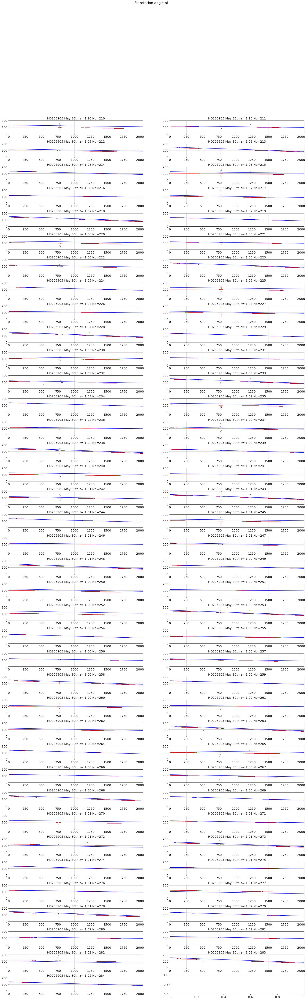

In [97]:
textfilename = os.path.join(inputdir,'star_centroids.txt')
central_positions = np.loadtxt(textfilename)

print all_angles
all_theta=ComputeRotationAngleHessian(all_images2,thex0,they0,all_titles,object_name)
for index in range(len(all_theta)):
    print index,' theta = ',all_theta[index], '\tx0 = ',central_positions[index][1], '\ty0 = ',central_positions[index][0]

### Choose here which rotation angle to apply

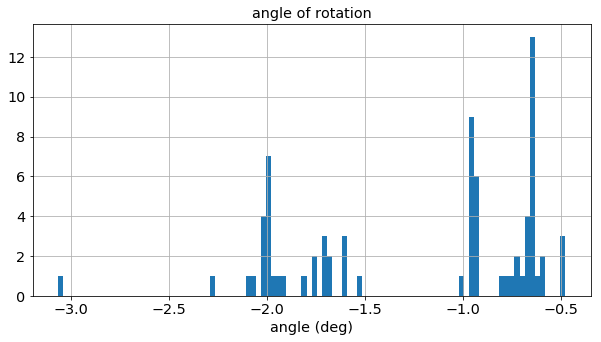

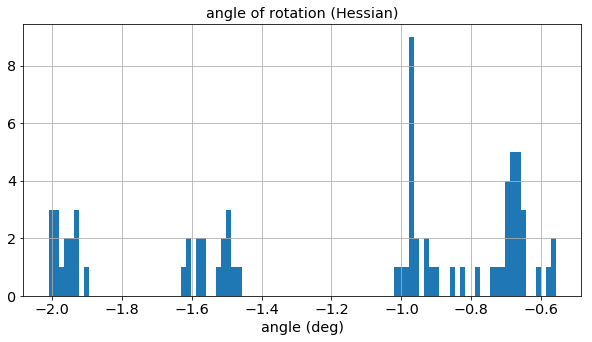

In [98]:
plt.figure(figsize=(10,5))
#hist(x, bins=10, range=None, normed=False, weights=None, cumulative=False, bottom=None, histtype='bar', align='mid', orientation='vertical', rwidth=None, log=False, color=None, label=None, stacked=False, hold=None, data=None, **kwargs)
#n, bins, patches=plt.hist(all_angles,bins=50,range=[-1,.5],histtype='stepfilled')
n, bins, patches=plt.hist(all_angles,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation')
plt.xlabel('angle (deg)')
plt.figure(figsize=(10,5))
#hist(x, bins=10, range=None, normed=False, weights=None, cumulative=False, bottom=None, histtype='bar', align='mid', orientation='vertical', rwidth=None, log=False, color=None, label=None, stacked=False, hold=None, data=None, **kwargs)
#n, bins, patches=plt.hist(all_angles,bins=50,range=[-1,.5],histtype='stepfilled')
n, bins, patches=plt.hist(all_theta,bins=100,histtype='stepfilled')
plt.grid(True)
plt.title('angle of rotation (Hessian)')
plt.xlabel('angle (deg)')

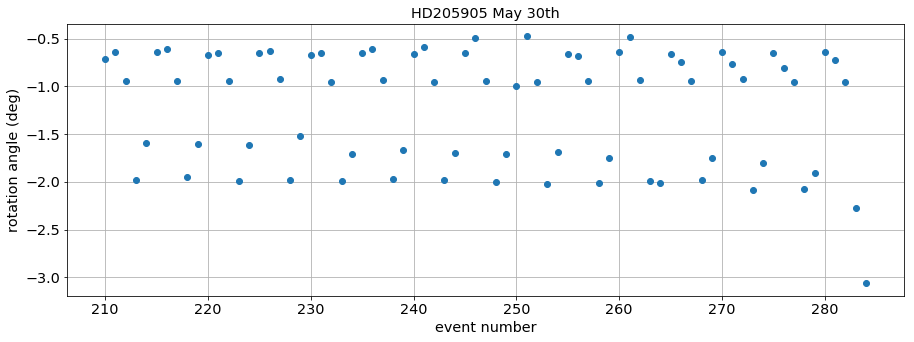

In [99]:
plt.figure(figsize=(15,5))
plt.plot(indexes_files,all_angles,'o')
plt.grid(True)
plt.ylabel('rotation angle (deg)')
plt.xlabel('event number')
plt.title(object_name)
figfilename=os.path.join(dir_top_images,'rotationvsevnum.pdf')
plt.savefig(figfilename) 

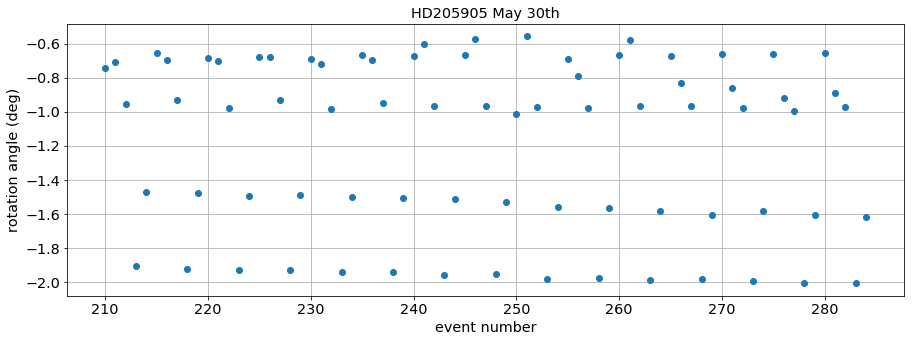

In [100]:
plt.figure(figsize=(15,5))
plt.plot(indexes_files,all_theta,'o')
plt.grid(True)
plt.ylabel('rotation angle (deg)')
plt.xlabel('event number')
plt.title(object_name)
figfilename=os.path.join(dir_top_images,'rotationvsevnum_hessian.pdf')
plt.savefig(figfilename) 

Avec la méthode Hessienne, on voit qu'on obtient des séries de 5 points : une première qui monte, une deuxième plate (donc la bonne hauteur de l'image en y ?) et trois descendantes.

## Now turn the images accordingly

In [101]:
def TurnTheImages(all_images,all_angles,all_titles,object_name,dir_top_images):
    """
    TurnTheImages
    =============
    
    input:
    ------
    all_images:
    all_angles:
    
    
    output:
    ------
    all_rotated_images
    
    """
    NBIMAGES=len(all_images)
    NBIMGPERROW=2
    MAXIMGROW=int(NBIMAGES/NBIMGPERROW)+1
    
    all_rotated_images = []

    f, axarr = plt.subplots(MAXIMGROW,NBIMGPERROW,figsize=(25,3*MAXIMGROW))
    for index in np.arange(0,NBIMAGES):
        ix=index%NBIMGPERROW
        iy=index/NBIMGPERROW
        
        image=all_images[index]    
        angle=all_angles[index]    
        data=np.copy(image)
        
        rotated_image=ndimage.interpolation.rotate(data,angle)
        
        all_rotated_images.append(rotated_image)
        
        im=axarr[iy,ix].imshow(rotated_image,origin='lower',cmap='rainbow',vmin=0,vmax=800)
        #im=axarr[iy,ix].plot(x_new,y_new,'b-')
        axarr[iy,ix].set_title(all_titles[index])
        axarr[iy,ix].grid(color='white', ls='solid')
        
        axarr[iy,ix].grid(True)
        
    title='Rotated images for '.format(object_name)    
    plt.suptitle(title,size=16)
    
    figfilename=os.path.join(dir_top_images,'rotated_images.pdf')
    plt.savefig(figfilename)  
    
    return all_rotated_images

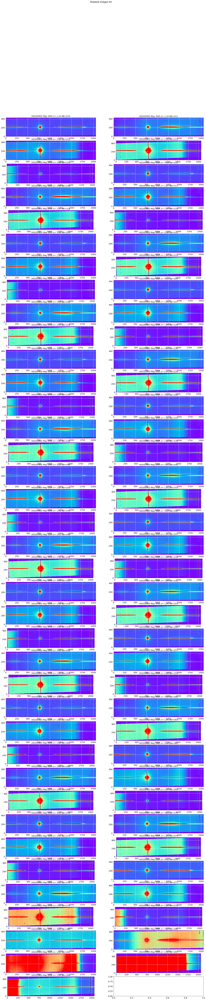

In [102]:
# J'utilise les angles qui viennent de la méthode Hessienne ici
turned_images=TurnTheImages(all_images,all_theta,all_titles,object_name,dir_top_images) #same rotation for each image

## Check rotation

In case of bad rotation, check by eye

In [103]:
sel=4

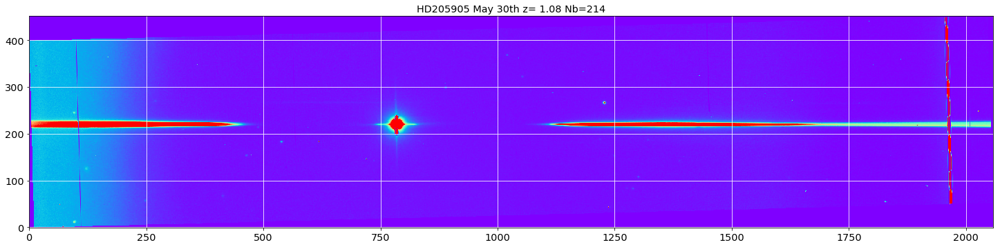

In [104]:
plt.figure(figsize=(25,10))
plt.imshow(turned_images[sel],origin='lower',cmap='rainbow',vmin=0,vmax=1000)
plt.grid(True)
plt.title(all_titles[sel])
plt.grid(color='white', ls='solid')
figfilename=os.path.join(dir_top_images,'rotated_image_sample.pdf')
plt.savefig(figfilename)  

array([ 0.00751396,  0.02299132,  0.02068527,  0.01862766,  0.04067461,
       -0.00712441,  0.0017892 , -0.05137546,  0.0513208 ,  0.02095543,
       -0.00095703,  0.01012337,  0.02755741,  0.04155871,  0.03806837,
        0.00297944, -0.00695504, -0.01934786,  0.0398763 ,  0.05005973,
        0.00948944,  0.01583379,  0.01411475,  0.04666752,  0.02474078,
        0.00963207, -0.00257782,  0.00531038,  0.02851093,  0.02726559,
        0.00646217, -0.01975629, -0.01693245,  0.03721552,  0.01830216,
        0.00072775,  0.01406147, -0.0111804 ,  0.04003985,  0.03201272,
        0.01299603,  0.0115772 , -0.03157435,  0.04270413,  0.03052178,
        0.01476461,  0.03357899,  0.021364  ,  0.05418088,  0.03574955,
       -0.00445421,  0.01041064,  0.02977327,  0.0535519 ,  0.02422405,
        0.01664418, -0.0016473 ,  0.00278905,  0.03999263,  0.03553437,
        0.00169115,  0.00732748,  0.00639062,  0.0467638 ,  0.02601453,
       -0.00843768,  0.0052911 , -0.01791846,  0.04705922,  0.03

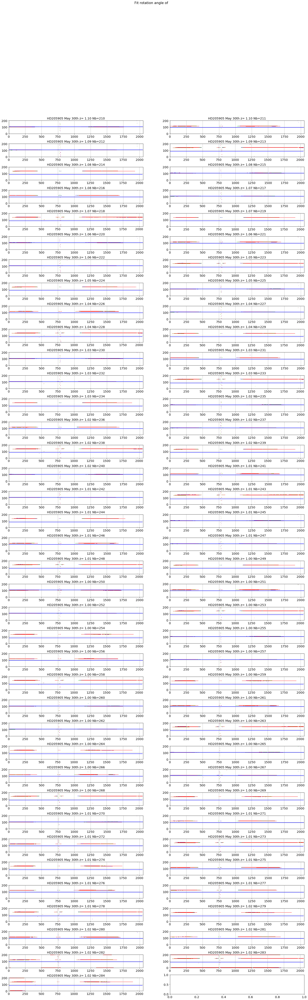

In [105]:
image_sel=np.copy(turned_images[sel])
y0=they0[sel]
x0=thex0[sel]

region=np.copy(image_sel[y0-width_cut:y0+width_cut,:])
data=np.copy(region)

ComputeRotationAngleHessian(turned_images,thex0,they0,all_titles,object_name)

In [106]:
sorted_files

array(['cut_fitsimages/cutimg_20170530_210.fits',
       'cut_fitsimages/cutimg_20170530_211.fits',
       'cut_fitsimages/cutimg_20170530_212.fits',
       'cut_fitsimages/cutimg_20170530_213.fits',
       'cut_fitsimages/cutimg_20170530_214.fits',
       'cut_fitsimages/cutimg_20170530_215.fits',
       'cut_fitsimages/cutimg_20170530_216.fits',
       'cut_fitsimages/cutimg_20170530_217.fits',
       'cut_fitsimages/cutimg_20170530_218.fits',
       'cut_fitsimages/cutimg_20170530_219.fits',
       'cut_fitsimages/cutimg_20170530_220.fits',
       'cut_fitsimages/cutimg_20170530_221.fits',
       'cut_fitsimages/cutimg_20170530_222.fits',
       'cut_fitsimages/cutimg_20170530_223.fits',
       'cut_fitsimages/cutimg_20170530_224.fits',
       'cut_fitsimages/cutimg_20170530_225.fits',
       'cut_fitsimages/cutimg_20170530_226.fits',
       'cut_fitsimages/cutimg_20170530_227.fits',
       'cut_fitsimages/cutimg_20170530_228.fits',
       'cut_fitsimages/cutimg_20170530_229.fits',


In [107]:
newfullfilenames=[]
for idx,file in np.ndenumerate(sorted_files):
    short_infilename=file.split("/")[1]
    short_partfilename=re.findall('^cutimg_(.*)',short_infilename)
    short_outfilename='rotimg_'+short_partfilename[0]
    newfullfilename=os.path.join(outputdir,short_outfilename)
    newfullfilenames.append(newfullfilename)

In [108]:
newfullfilenames

['./rotated_fitsimages/rotimg_20170530_210.fits',
 './rotated_fitsimages/rotimg_20170530_211.fits',
 './rotated_fitsimages/rotimg_20170530_212.fits',
 './rotated_fitsimages/rotimg_20170530_213.fits',
 './rotated_fitsimages/rotimg_20170530_214.fits',
 './rotated_fitsimages/rotimg_20170530_215.fits',
 './rotated_fitsimages/rotimg_20170530_216.fits',
 './rotated_fitsimages/rotimg_20170530_217.fits',
 './rotated_fitsimages/rotimg_20170530_218.fits',
 './rotated_fitsimages/rotimg_20170530_219.fits',
 './rotated_fitsimages/rotimg_20170530_220.fits',
 './rotated_fitsimages/rotimg_20170530_221.fits',
 './rotated_fitsimages/rotimg_20170530_222.fits',
 './rotated_fitsimages/rotimg_20170530_223.fits',
 './rotated_fitsimages/rotimg_20170530_224.fits',
 './rotated_fitsimages/rotimg_20170530_225.fits',
 './rotated_fitsimages/rotimg_20170530_226.fits',
 './rotated_fitsimages/rotimg_20170530_227.fits',
 './rotated_fitsimages/rotimg_20170530_228.fits',
 './rotated_fitsimages/rotimg_20170530_229.fits',


### Save outputfilename

In [109]:
for idx,file in np.ndenumerate(newfullfilenames):
    prihdu = fits.PrimaryHDU(header=all_header[idx[0]],data=turned_images[idx[0]])
    thdulist = fits.HDUList(prihdu)
    thdulist.writeto(file,overwrite=True)

In [110]:
!ls -l rotated_fitsimages

total 1067040
-rw-r--r--  1 dagoret-campagnesylvie  staff  7009920 Jun  8 22:30 rotimg_20170530_210.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6992640 Jun  8 22:30 rotimg_20170530_211.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7145280 Jun  8 22:30 rotimg_20170530_212.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7724160 Jun  8 22:30 rotimg_20170530_213.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7453440 Jun  8 22:30 rotimg_20170530_214.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6958080 Jun  8 22:30 rotimg_20170530_215.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6992640 Jun  8 22:30 rotimg_20170530_216.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7128000 Jun  8 22:30 rotimg_20170530_217.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7724160 Jun  8 22:30 rotimg_20170530_218.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  7470720 Jun  8 22:30 rotimg_20170530_219.fits
-rw-r--r--  1 dagoret-campagnesylvie  staff  6992640 Jun  8 22:30 rotimg_201

In [111]:
!pwd

/Users/dagoret-campagnesylvie/MacOsX/LSST/MyWork/GitHub/CTIOAnaJun2017/ana_30may17/HD205905


In [112]:
!ls

Extract_Spectrum.ipynb    ViewAllImages.ipynb       reduced_fitsimages
FindCentralStarFast.ipynb cut_fitsimages            rotated_fitsimages
FindOptRot.ipynb          images_notebooks          spectrum_fitsspec
ReduceAllImages.ipynb     processed_fitsimages
